## SIVR: Multi City Visualization
Ref: [When zombies attack!: Mathematical modelling of an outbreak of zombie infection (Munz et al.)](https://www.loe.org/images/content/091023/Zombie%20Publication.pdf)

In [3]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
from matplotlib import animation
from IPython.display import HTML
import numba  # For JIT compilation to speed up computations

In [4]:
# Define grid sizes
city_grid_size = 100  # Size of each city grid
num_cities_x = 3      # Number of cities horizontally
num_cities_y = 3      # Number of cities vertically
total_grid_size_x = city_grid_size * num_cities_x
total_grid_size_y = city_grid_size * num_cities_y

# Define states
# 0: Empty, 1: Susceptible, 2: Infected, 3: Zombie, 4: Removed
EMPTY = 0
SUSCEPTIBLE = 1
INFECTED = 2
ZOMBIE = 3
REMOVED = 4

# City parameters (base rates for Tucson, other cities will have variations)
# Based on the Munz et al. paper but adapted for cellular automata
# These parameters can be adjusted to create different scenarios
PARAMS = {
    'Tucson': {
        'beta': 0.5,      # Transmission probability (S to I when encountering Z)
        'rho': 0.3,       # Rate at which infected become zombies
        'alpha': 0.1,     # Rate at which zombies are destroyed when encountering S
        'zeta': 0.05,     # Rate at which removed resurrect as zombies
        'delta': 0.01,    # Natural death rate
        'pi': 0.02,       # Birth rate (new susceptibles)
        'density': 0.4,   # Initial population density
        'position': (1, 1)  # Center position (will be Tucson)
    },
    'Phoenix': {
        'beta': 0.55,     # Higher transmission in dense urban area
        'rho': 0.3,
        'alpha': 0.08,    # Slightly less effective defense
        'zeta': 0.05,
        'delta': 0.01,
        'pi': 0.025,      # Slightly higher birth rate
        'density': 0.5,   # Higher population density
        'position': (0, 0)  # Northwest position
    },
    'Flagstaff': {
        'beta': 0.45,     # Lower transmission in less dense area
        'rho': 0.25,      # Slower zombification (cooler climate)
        'alpha': 0.15,    # Better defense (isolated community)
        'zeta': 0.04,
        'delta': 0.01,
        'pi': 0.015,
        'density': 0.25,  # Lower population density
        'position': (0, 1)  # North position
    },
    'Sedona': {
        'beta': 0.4,
        'rho': 0.25,
        'alpha': 0.2,     # Better defense (isolated, prepared community)
        'zeta': 0.03,
        'delta': 0.01,
        'pi': 0.01,
        'density': 0.2,   # Low population density
        'position': (0, 2)  # Northeast position
    },
    'Yuma': {
        'beta': 0.5,
        'rho': 0.35,      # Faster zombification (hot climate)
        'alpha': 0.1,
        'zeta': 0.06,     # Faster resurrection (hot climate)
        'delta': 0.01,
        'pi': 0.02,
        'density': 0.3,
        'position': (1, 0)  # West position
    },
    'Sierra Vista': {
        'beta': 0.45,
        'rho': 0.3,
        'alpha': 0.12,    # Better defense (military presence)
        'zeta': 0.05,
        'delta': 0.01,
        'pi': 0.02,
        'density': 0.3,
        'position': (2, 0)  # Southwest position
    },
    'Globe': {
        'beta': 0.45,
        'rho': 0.3,
        'alpha': 0.1,
        'zeta': 0.05,
        'delta': 0.01,
        'pi': 0.015,
        'density': 0.25,   # Lower population density
        'position': (2, 1)  # South position
    },
    'Safford': {
        'beta': 0.45,
        'rho': 0.3,
        'alpha': 0.1,
        'zeta': 0.05,
        'delta': 0.01,
        'pi': 0.015,
        'density': 0.25,
        'position': (2, 2)  # Southeast position
    },
    'Casa Grande': {
        'beta': 0.5,
        'rho': 0.3,
        'alpha': 0.1,
        'zeta': 0.05,
        'delta': 0.01,
        'pi': 0.02,
        'density': 0.35,
        'position': (1, 2)  # East position
    }
}

In [6]:
# Create color maps for visualization
def create_beautiful_colormap():
    colors = [
        (0, 0, 0.1),              # Empty (dark blue)
        (0, 0.8, 0.4),            # Susceptible (teal-green)
        (1, 0.8, 0.1),            # Infected (yellow-orange)
        (0.9, 0.2, 0),            # Zombie (red)
        (0.6, 0.3, 0.6)           # Removed (purple)
    ]
    
    return ListedColormap(colors)

# Set up the initial grid for the multi-city simulation
def initialize_multi_city_grid():
    """Initialize a grid with multiple cities, each with its own parameters"""
    # Create an empty grid
    grid = np.zeros((total_grid_size_y, total_grid_size_x), dtype=np.int8)
    
    # Create a parameter grid to store which parameters apply to each cell
    param_grid = np.zeros((total_grid_size_y, total_grid_size_x, 6), dtype=np.float32)
    
    # Create a grid to track which city each cell belongs to
    city_label_grid = np.zeros((total_grid_size_y, total_grid_size_x), dtype=np.int8)
    
    # City ID mapping
    city_ids = {}
    
    # Initialize each city with its parameters
    city_id = 1
    for city_name, params in PARAMS.items():
        y_pos, x_pos = params['position']
        
        # Calculate grid slice for this city
        y_start = y_pos * city_grid_size
        y_end = (y_pos + 1) * city_grid_size
        x_start = x_pos * city_grid_size
        x_end = (x_pos + 1) * city_grid_size
        
        # Store city ID mapping
        city_ids[city_id] = city_name
        
        # Fill city label grid
        city_label_grid[y_start:y_end, x_start:x_end] = city_id
        
        # Set parameters for this city's region
        param_grid[y_start:y_end, x_start:x_end, 0] = params['beta']    # Transmission rate
        param_grid[y_start:y_end, x_start:x_end, 1] = params['rho']     # Zombification rate
        param_grid[y_start:y_end, x_start:x_end, 2] = params['alpha']   # Zombie destruction rate
        param_grid[y_start:y_end, x_start:x_end, 3] = params['zeta']    # Resurrection rate
        param_grid[y_start:y_end, x_start:x_end, 4] = params['delta']   # Natural death rate
        param_grid[y_start:y_end, x_start:x_end, 5] = params['pi']      # Birth rate
        
        # Initialize susceptible population based on density
        random_grid = np.random.random((y_end - y_start, x_end - x_start))
        grid[y_start:y_end, x_start:x_end][random_grid < params['density']] = SUSCEPTIBLE
        
        city_id += 1
    
    # Add initial zombies - start in Tucson (center city)
    tucson_y, tucson_x = PARAMS['Tucson']['position']
    center_y = tucson_y * city_grid_size + city_grid_size // 2
    center_x = tucson_x * city_grid_size + city_grid_size // 2
    
    # Place a cluster of zombies near the center of Tucson
    for i in range(-2, 3):
        for j in range(-2, 3):
            if np.random.random() < 0.7:  # 70% chance for each cell in the cluster
                grid[center_y + i, center_x + j] = ZOMBIE
    
    return grid, param_grid, city_label_grid, city_ids

# Pre-compute neighbor offsets for faster access
NEIGHBOR_OFFSETS = np.array([
    (-1, -1), (-1, 0), (-1, 1),
    (0, -1),           (0, 1),
    (1, -1),  (1, 0),  (1, 1)
])

# JIT compile the update function for speed
@numba.njit
def update_multi_city_grid(grid, param_grid, rng_seed=None):
    """Update the grid according to zombie infection rules with city-specific parameters"""
    if rng_seed is not None:
        np.random.seed(rng_seed)
    
    rows, cols = grid.shape
    new_grid = grid.copy()
    
    # Create random numbers in advance for different state transitions
    random_vals = np.random.random((rows, cols, 4))
    
    for i in range(rows):
        for j in range(cols):
            state = grid[i, j]
            
            # Get parameters for this cell's location
            beta = param_grid[i, j, 0]    # Transmission rate
            rho = param_grid[i, j, 1]     # Zombification rate
            alpha = param_grid[i, j, 2]   # Zombie destruction rate
            zeta = param_grid[i, j, 3]    # Resurrection rate
            delta = param_grid[i, j, 4]   # Natural death rate
            pi = param_grid[i, j, 5]      # Birth rate
            
            # Count neighbors more efficiently
            zombie_neighbors = 0
            susceptible_neighbors = 0
            
            for di, dj in NEIGHBOR_OFFSETS:
                ni, nj = (i + di) % rows, (j + dj) % cols
                neighbor_state = grid[ni, nj]
                if neighbor_state == ZOMBIE:
                    zombie_neighbors += 1
                elif neighbor_state == SUSCEPTIBLE:
                    susceptible_neighbors += 1
            
            # Use pre-computed random values
            r1, r2, r3, r4 = random_vals[i, j]
            
            # Apply transition rules
            if state == EMPTY:
                if r1 < pi:
                    new_grid[i, j] = SUSCEPTIBLE
            
            elif state == SUSCEPTIBLE:
                # Infection from zombie neighbors
                if zombie_neighbors > 0 and r1 < beta * zombie_neighbors / 8:
                    new_grid[i, j] = INFECTED
                # Natural death
                elif r2 < delta:
                    new_grid[i, j] = REMOVED
            
            elif state == INFECTED:
                if r1 < rho:
                    new_grid[i, j] = ZOMBIE
                elif r2 < delta:
                    new_grid[i, j] = REMOVED
            
            elif state == ZOMBIE:
                # Destruction when encountering susceptibles
                if susceptible_neighbors > 0 and r1 < alpha * susceptible_neighbors / 8:
                    new_grid[i, j] = REMOVED
                # Zombies move randomly
                elif r2 < 0.5:  # 50% chance to move
                    # Choose direction based on r3
                    direction = int(r3 * 8)
                    di, dj = NEIGHBOR_OFFSETS[direction]
                    ni, nj = (i + di) % rows, (j + dj) % cols
                    
                    if grid[ni, nj] == EMPTY:
                        new_grid[i, j] = EMPTY
                        new_grid[ni, nj] = ZOMBIE
            
            elif state == REMOVED:
                if r1 < zeta:
                    new_grid[i, j] = ZOMBIE
    
    # Simulate migration between cities (zombies crossing city boundaries)
    for i in range(rows):
        for j in range(cols):
            if new_grid[i, j] == ZOMBIE:
                # Small chance for zombies to travel long distances
                if np.random.random() < 0.01:  # 1% chance
                    # Choose a random distant location
                    new_i = np.random.randint(0, rows)
                    new_j = np.random.randint(0, cols)
                    
                    if new_grid[new_i, new_j] == EMPTY:
                        new_grid[i, j] = EMPTY
                        new_grid[new_i, new_j] = ZOMBIE
    
    return new_grid

# Function to count population by city
def count_population_by_city(grid, city_label_grid, city_ids):
    """Count the number of individuals in each state for each city"""
    city_stats = {}
    
    for city_id, city_name in city_ids.items():
        # Create mask for this city
        city_mask = (city_label_grid == city_id)
        
        # Get grid cells for just this city
        city_grid = grid[city_mask]
        
        # Count states
        unique, counts = np.unique(city_grid, return_counts=True)
        population = {state: 0 for state in range(5)}  # Initialize all states with zero
        
        for state, count in zip(unique, counts):
            population[state] = count
        
        city_stats[city_name] = population
    
    return city_stats

# Function to track overall population
def count_overall_population(grid):
    """Count the total number of individuals in each state"""
    unique, counts = np.unique(grid, return_counts=True)
    population = {state: 0 for state in range(5)}  # Initialize all states with zero
    
    for state, count in zip(unique, counts):
        population[state] = count
    
    return population

# Function to run simulation with sparse frame saving
def run_multi_city_simulation(num_frames=100, save_interval=2, interval=100):
    """Run the multi-city simulation"""
    grid, param_grid, city_label_grid, city_ids = initialize_multi_city_grid()
    
    # Create figure with subplots
    fig = plt.figure(figsize=(16, 12))
    
    # Main grid visualization
    grid_ax = plt.subplot2grid((3, 4), (0, 0), colspan=3, rowspan=2)
    
    # Overall population plot
    overall_ax = plt.subplot2grid((3, 4), (0, 3), rowspan=1)
    
    # City boundary visualization
    boundary_ax = plt.subplot2grid((3, 4), (1, 3), rowspan=1)
    
    # City-specific population plots
    city_axes = []
    for i in range(4):
        city_axes.append(plt.subplot2grid((3, 4), (2, i)))
    
    # Create colormap
    cmap = create_beautiful_colormap()
    
    # Initial plot of the grid
    grid_img = grid_ax.imshow(grid, cmap=cmap, vmin=0, vmax=4)
    grid_ax.set_title('Multi-City Zombie Outbreak Simulation - Arizona', fontsize=16)
    grid_ax.axis('off')
    
    # Plot city boundaries
    boundary_img = boundary_ax.imshow(city_label_grid, cmap='tab20', interpolation='nearest')
    boundary_ax.set_title('City Regions')
    boundary_ax.axis('off')
    
    # Add city name annotations to the boundary map
    for city_id, city_name in city_ids.items():
        y_pos, x_pos = PARAMS[city_name]['position']
        center_y = y_pos * city_grid_size + city_grid_size // 2
        center_x = x_pos * city_grid_size + city_grid_size // 2
        boundary_ax.text(center_x, center_y, city_name, 
                        horizontalalignment='center',
                        verticalalignment='center',
                        fontsize=8, color='black',
                        bbox=dict(facecolor='white', alpha=0.7))
    
    # Initialize data storage
    frames = []
    city_population_history = []
    overall_population_history = []
    
    # Calculate which frames to save
    save_frames = list(range(0, num_frames+1, save_interval))
    if num_frames not in save_frames:
        save_frames.append(num_frames)
    
    # Add initial frame
    frames.append(grid.copy())
    city_population_history.append(count_population_by_city(grid, city_label_grid, city_ids))
    overall_population_history.append(count_overall_population(grid))
    
    # Run the simulation
    print(f"Running simulation: {num_frames} frames")
    for i in range(1, num_frames+1):
        # Update the grid
        grid = update_multi_city_grid(grid, param_grid)
        
        # Save frame if it's in the save list
        if i in save_frames:
            frames.append(grid.copy())
            city_population_history.append(count_population_by_city(grid, city_label_grid, city_ids))
            overall_population_history.append(count_overall_population(grid))
            
        # Show progress
        if i % 10 == 0:
            print(f"Processed frame {i}/{num_frames}", end='\r')
    
    print("\nPreparing animation...")
    
    # Process overall population data for plotting
    steps = np.array(save_frames)
    empty_data = np.array([p.get(EMPTY, 0) for p in overall_population_history])
    susceptible_data = np.array([p.get(SUSCEPTIBLE, 0) for p in overall_population_history])
    infected_data = np.array([p.get(INFECTED, 0) for p in overall_population_history])
    zombie_data = np.array([p.get(ZOMBIE, 0) for p in overall_population_history])
    removed_data = np.array([p.get(REMOVED, 0) for p in overall_population_history])
    
    # Set up the overall population plot
    overall_ax.set_xlim(0, num_frames)
    max_pop = total_grid_size_x * total_grid_size_y
    overall_ax.set_ylim(0, max_pop)
    overall_ax.set_xlabel('Time Step')
    overall_ax.set_ylabel('Population')
    overall_ax.set_title('Overall Population')
    
    # Line plots for overall population
    overall_empty_line, = overall_ax.plot([], [], color='#00001A', label='Empty')
    overall_susceptible_line, = overall_ax.plot([], [], color='#00CC99', label='Susceptible')
    overall_infected_line, = overall_ax.plot([], [], color='#FFCC33', label='Infected')
    overall_zombie_line, = overall_ax.plot([], [], color='#CC0000', label='Zombie')
    overall_removed_line, = overall_ax.plot([], [], color='#660066', label='Removed')
    overall_ax.legend(fontsize=8)
    
    # Process city data for the most interesting cities
    featured_cities = ['Tucson', 'Phoenix', 'Flagstaff', 'Sedona']
    city_data = {city: {} for city in featured_cities}
    
    for city in featured_cities:
        city_data[city]['susceptible'] = np.array([h[city].get(SUSCEPTIBLE, 0) for h in city_population_history])
        city_data[city]['infected'] = np.array([h[city].get(INFECTED, 0) for h in city_population_history])
        city_data[city]['zombie'] = np.array([h[city].get(ZOMBIE, 0) for h in city_population_history])
        city_data[city]['removed'] = np.array([h[city].get(REMOVED, 0) for h in city_population_history])
    
    # Set up the city plots
    city_lines = {}
    for i, city in enumerate(featured_cities):
        city_axes[i].set_xlim(0, num_frames)
        city_axes[i].set_ylim(0, city_grid_size * city_grid_size)
        city_axes[i].set_xlabel('Time Step')
        if i == 0:
            city_axes[i].set_ylabel('Population')
        city_axes[i].set_title(f'{city}')
        
        city_lines[city] = {}
        city_lines[city]['susceptible'], = city_axes[i].plot([], [], color='#00CC99', label='Susceptible')
        city_lines[city]['infected'], = city_axes[i].plot([], [], color='#FFCC33', label='Infected')
        city_lines[city]['zombie'], = city_axes[i].plot([], [], color='#CC0000', label='Zombie')
        city_lines[city]['removed'], = city_axes[i].plot([], [], color='#660066', label='Removed')
        city_axes[i].legend(fontsize=8)
    
    # Animation update function
    def update(frame_idx):
        # Map animation frame to saved frame index
        frame = frame_idx
        if frame >= len(frames):
            frame = len(frames) - 1
            
        # Update the grid visualization
        grid_img.set_array(frames[frame])
        
        # Update the overall population plot
        overall_empty_line.set_data(steps[:frame+1], empty_data[:frame+1])
        overall_susceptible_line.set_data(steps[:frame+1], susceptible_data[:frame+1])
        overall_infected_line.set_data(steps[:frame+1], infected_data[:frame+1])
        overall_zombie_line.set_data(steps[:frame+1], zombie_data[:frame+1])
        overall_removed_line.set_data(steps[:frame+1], removed_data[:frame+1])
        
        # Update city plots
        for city in featured_cities:
            city_lines[city]['susceptible'].set_data(steps[:frame+1], city_data[city]['susceptible'][:frame+1])
            city_lines[city]['infected'].set_data(steps[:frame+1], city_data[city]['infected'][:frame+1])
            city_lines[city]['zombie'].set_data(steps[:frame+1], city_data[city]['zombie'][:frame+1])
            city_lines[city]['removed'].set_data(steps[:frame+1], city_data[city]['removed'][:frame+1])
        
        # Return all artists that need to be updated
        artists = [grid_img, overall_empty_line, overall_susceptible_line, 
                  overall_infected_line, overall_zombie_line, overall_removed_line]
        
        for city in featured_cities:
            artists.extend([city_lines[city]['susceptible'], city_lines[city]['infected'], 
                           city_lines[city]['zombie'], city_lines[city]['removed']])
        
        return artists
    
    # Create the animation
    plt.tight_layout()
    anim = animation.FuncAnimation(fig, update, frames=len(frames), interval=interval, blit=True)
    
    return HTML(anim.to_jshtml())

## Demonstration

Running simulation: 200 frames
Processed frame 200/200
Preparing animation...


Animation size has reached 21800211 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


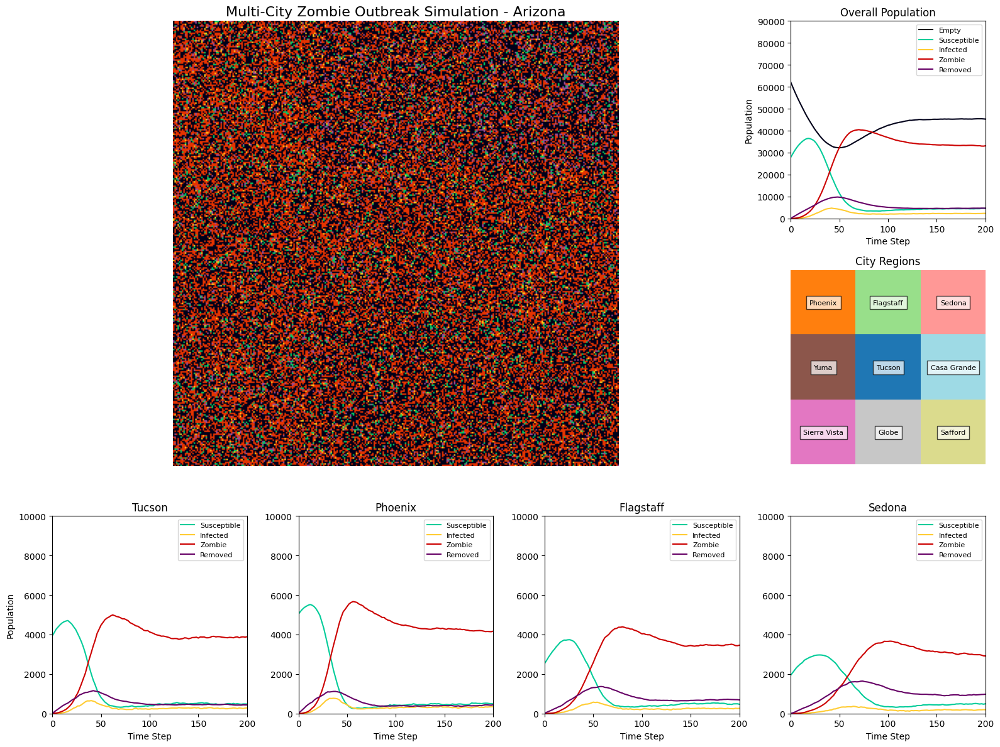

In [ ]:
# Run the multi-city simulation
# NOTE: Due to the large size of the animation here I elected not to capture all frames
run_multi_city_simulation(num_frames=200, save_interval=2, interval=100)